In [1]:
import urllib.request
import json
import pandas as pd
import re
import networkx as nx
import unidecode
import nltk
# nltk.download('all')
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import numpy as np
import powerlaw
from fa2 import ForceAtlas2
import cv2
import requests
import requests 
from bs4 import BeautifulSoup
from kaggle.api.kaggle_api_extended import KaggleApi
import zipfile


# Gathering data for analysis

To explore The Office, we use several datasets: 

 - We first extract all the characters that played in the Office from season 1 to season 9 (final). This is extracted using **Dunderpedia: The Office Wiki**: https://theoffice.fandom.com/
 
 
 - A description of each character is downloaded from the same source: **Dunderpedia: The Office Wiki**. This data is used to extract the sentiment of each character and will later be compared to the sentiment extracted from the episodes transcripts. We would like to validate that the character description is based on the character developemnt over all seasons. 
 
 
 - We then want to analyse episodes ratings The Office and how they change overtime. We use the **IMDb**  to extract: episode title, IMDb rating, total votes ad air date. The source is: https://www.imdb.com/title/tt0386676/episodes/_ajax
 
 
 - From Kaggle we download the guest starts, directors adn writers https://www.kaggle.com/andreal314159/the-office-analysis-for-datacamp/data. We use this data to analyse the impact of guest starts, directors and writers in the ratings. 
 
 
 - Next, to further analyse the episodes raitings, we want to get information about the episode itself, such as the characters that played in it, how many lines they had in every episode and so on. This is collected from a **Kaggle dataset: The Office (US) - Complete Dialogue/Transcript**
https://www.kaggle.com/nasirkhalid24/the-office-us-complete-dialoguetranscript/version/1?select=The-Office-Lines.csv

# Building the network - Dunderpedia: The Office Wiki

**To create our network, we downloaded the Dunderpedia: The Office Wiki pages for all characters in the series and linked them via the hyperlinks connecting pages to each other by examining their contents. To achieve this goal we have used regular expressions!**

To collect the hyperlinks from the character pages, we had to extract the list of character names from the The Office API, and saved this information into a csv file: `characters.csv`.  

Once the list of The Office characters had been collected, we collect the page information in order to extract the characters race, gender and hyperlinks. 

To do this we make an API request. We found the baseurl `https://theoffice.fandom.com/api.php?` and title for each of the characters, and we built related API queries for each of them. Then, we made the requests for each query. For each character, we save the resulting page content in a txt file.

We need to extract the characters data from: https://theoffice.fandom.com/api.php?action=query&format=json&list=categorymembers&cmtitle=Category:Characters&cmlimit=max

In [2]:
baseurl = "https://theoffice.fandom.com/api.php?" # the baseurl to build the API query, it's common for the three pages
action = "action=query"

# we create a list with the 3 titles from the 3 pages we want to extract the content from
title = "cmtitle=Category:Characters"

# add the parameter list=categorymembers to the query's content
content = "list=categorymembers&cmlimit=max"
dataformat ="format=json" # we want the return of the query to be json for future use when we extract the contents

# construct the query for the title
category_query = f"{baseurl}{action}&{content}&{title}&{dataformat}"
print(f"For title: {title.split('=')[1]}, the query is: {category_query}")

For title: Category:Characters, the query is: https://theoffice.fandom.com/api.php?action=query&list=categorymembers&cmlimit=max&cmtitle=Category:Characters&format=json


Get category members and extract the page ids and page titles for all chraracters

In [3]:
response = urllib.request.urlopen(category_query) # make the request to the query
data_response = response.read().decode('utf-8') # read the response and decode it
data_json = json.loads(data_response)['query']['categorymembers'] # convert the response to json format

page_ids = []
titles = []

for category in data_json:
    # we keep a list with the page indexes and titles to be used when extracting the content for the category pages
    page_ids.append(category['pageid'])
    titles.append(category['title'].replace(' ', '_'))

Next, we extract the description for each character. For the future analysis, it is neccessary to extract the characters categories and sub categories, which are:

In [4]:
main_categories = list(map(lambda title: title.casefold(), titles[:5]))
sub_categories = list(map(lambda title: title.casefold().replace('category:', ''), titles[-18:]))
characters = titles[5:-18]

In [5]:
print(f"Main categories: {main_categories}\n")
print(f"Sub categories: {sub_categories}")

Main categories: ['background_employees', 'clients_of_dunder_mifflin', 'main_characters', 'mentioned_characters', 'voiced_characters']

Sub categories: ['actors_of_the_3rd_floor', 'actors_of_threat_level_midnight', 'animals', 'characters_of_dwight_schrute', 'characters_of_michael_scott', 'deceased_characters', 'dunder_mifflin_employees', 'family_members', 'females', 'former_employees', 'it_guys', 'main_characters', 'males', 'the_3rd_floor_characters', 'threat_level_midnight_characters', 'unnamed', 'unseen_characters', 'warehouse_worker']


The API pages have been identified, now we extract the information as json format:

In [6]:
content = "prop=revisions&rvprop=content&rvslots=*"

queries = []
page_ids = page_ids[5:-18]
for i, page_id in enumerate(page_ids):
    title = characters[i]
    query = f"{baseurl}{action}&{content}&titles={title}&{dataformat}"
    queries.append(query)
    print(f"For title: {title}, the query is: {query}")

For title: A.J., the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=A.J.&format=json
For title: Abby, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Abby&format=json
For title: Alan, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Alan&format=json
For title: Alan_Brand, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Alan_Brand&format=json
For title: Alex, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Alex&format=json
For title: Alice, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslots=*&titles=Alice&format=json
For title: Amy, the query is: https://theoffice.fandom.com/api.php?action=query&prop=revisions&rvprop=content&rvslot

Next we follow the strategy we used to download the pages above, to download each character page. For each character, we save the resulting page content in a txt file.

We reuse the baseurl, content, action and dataformat, but use different titles to build the query. 

In [7]:
def get_character_roles(content):
    roles = {'Main Role': '', 'Secondary Roles': []}
    pattern = r'(?:\[\[Category\:)(.*?)\]\]'
    matches = re.findall(pattern, content)
    
    for match in matches:
        if match.casefold().replace(' ', '_') in main_categories: 
            roles['Main Role'] = match
        elif match.casefold().replace(' ', '_') in sub_categories: 
            roles['Secondary Roles'].append(match)
    return roles

In [8]:
contents = {'Name': [], 'Main Role': [], 'Secondary Roles': []}

for i, query in enumerate(queries):
    # make the actual requests using the urllib library for each of the previoysly initialized queries
    response = urllib.request.urlopen(query) # make the request to the query
    data_response = response.read().decode('utf-8') # read the response and decode it

    data_json = json.loads(data_response) # convert the response to json format
    name = data_json['query']['pages'][str(page_ids[i])]['title']
   
    contents['Name'].append(name) # add character name
    
    # the content that we want to find in the initial page is located at query/pages/'index'/revisions[0]/slots/main/*
    content = data_json['query']['pages'][str(page_ids[i])]['revisions'][0]['slots']['main']['*']
    
    roles = get_character_roles(content) # add character main and secondary roles
    if 'Main Role' in roles:
        contents['Main Role'].append(roles['Main Role'])
    if 'Secondary Roles' in roles:
        contents['Secondary Roles'].append(roles['Secondary Roles'])
    with open(f'./data/characters/{name}.txt', 'w+') as file:
        file.write(content)

Next we create a dataframe with the character names, main and secondary roles and we save this data as csv

In [22]:
df = pd.DataFrame.from_dict(contents)
# use the to_csv built in pandas function to save our data to a csv file called characters.csv
df.to_csv('data/characters.csv', index=False)

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 298 entries, 0 to 297
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Name             298 non-null    object
 1   Main Role        298 non-null    object
 2   Secondary Roles  298 non-null    object
dtypes: object(3)
memory usage: 7.1+ KB


Now we have extracted the contents from each character and we have them in json format. Each page corresponds to a character, which is a node in our network. Next we take the pages we have downloaded for each character. We now find all the hyperlinks in a character's page that link to another node of the network (e.g. another character). For this we use regular expressions.

In [24]:
def get_links(content):
    pattern1_matches = re.findall(r'\[\[(.*?)(?:\|.*?)?\]\]', content)
        
    # we need to check if the found matches are characters (i.e. they are present in the extracted df)
    pattern1_matches = list(filter(lambda x: x in list(df.Name), pattern1_matches))
    return pattern1_matches

In [25]:
links = []

for name in df.Name:
    with open(f'./data/characters/{name}.txt') as file:
        content = file.read()
        # use the get_links to extract the links using a regrex expression
        links.append(get_links(content))

In [26]:
df.insert(3, 'Links', links) # add all genders to dataframe

In [27]:
df.head() # display the new dataframe with the 3 new columns

,Name,Main Role,Secondary Roles,Links
0,A.J.,,[Males],"[Holly Flax, Holly Flax, Michael Scott, Pam Be..."
1,Abby,,"[Females, Family members]","[Stacy, Pam Beesly]"
2,Alan,,[],"[Kelly Kapoor, Ryan Howard, Pam Beesly]"
3,Alan Brand,,"[Dunder Mifflin employees, Former employees, M...","[Jan Levinson, Michael Scott, Oscar Martinez, ..."
4,Alex,,[Males],"[Pam Beesly, Alex, Karen Filippelli]"


Next we extract pictures for each character so that we can use them for the network nodes

In [28]:
content = "prop=images&rvprop=content&rvslots=*"

img_queries = []

for i, page_id in enumerate(page_ids):
    title = characters[i]
    query = f"{baseurl}{action}&{content}&titles={title}&{dataformat}"
    img_queries.append(query)
    print(f"For title: {title}, the query is: {query}")

For title: A.J., the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=A.J.&format=json
For title: Abby, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Abby&format=json
For title: Alan, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Alan&format=json
For title: Alan_Brand, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Alan_Brand&format=json
For title: Alex, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Alex&format=json
For title: Alice, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Alice&format=json
For title: Amy, the query is: https://theoffice.fandom.com/api.php?action=query&prop=images&rvprop=content&rvslots=*&titles=Amy&format

In [29]:
images = {}
errors = []
for i, query in enumerate(img_queries):
    # make the actual requests using the urllib library for each of the previoysly initialized queries
    response = urllib.request.urlopen(query) # make the request to the query
    data_response = response.read().decode('utf-8') # read the response and decode it

    data_json = json.loads(data_response) # convert the response to json format
    name = content = data_json['query']['pages'][str(page_ids[i])]['title']
    
    try:
        # the content that we want to find in the initial page is located at query/pages/'index'/revisions[0]/slots/main/*
         
        img_title = data_json['query']['pages'][str(page_ids[i])]['images'][0]['title']
        img_index = 0
        while 'gif' in img_title:
            img_title = data_json['query']['pages'][str(page_ids[i])]['images'][img_index+1]['title']

        content = 'prop=pageimages'
        query_img = f"{baseurl}{action}&{content}&titles={img_title.replace(' ', '_').replace('&', '%26')}&{dataformat}"
        response = urllib.request.urlopen(query_img) # make the request to the query
        img_response = response.read() # read the response and decode it
        data_json = json.loads(img_response) # convert the response to json format
        pages = data_json['query']['pages']
        
        page = list(pages.values())[0]
        img_url = page['thumbnail']['source']
        img_data = requests.get(img_url).content
        
        extension = img_title.split('.')[-1] if 'gif' not in img_title.split('.')[-1] else 'png'
        path =  "./data/thumbnails/" + characters[i] + "." + extension
        images[characters[i]] = characters[i] + "." + extension

        with open(path, 'wb') as file:
            file.write(img_data)
    except Exception:
        errors.append(characters[i].replace('_', ' '))

Cleanup the dataset and remove all those characters that do not have a thumbnail, they should not be included in the network

In [31]:
df = df[~df['Name'].isin(errors)]

In [32]:
df.insert(4, 'ImagePath', images.values()) # add all races to dataframe

Next, we generate the The Office network and extract the giant connected component. We use `NetworkX DiGraph` to store the network and we store also the properties of the nodes (i.e. Main Role, Sub role and Image).

In [33]:
G = nx.DiGraph()

# iterate through all the rows in pandas df and add nodes
for index, row in df.iterrows():
    name = row['Name']
    img = row['ImagePath']
    main_role = row['Main Role']
    sub_roles = row['Secondary Roles']
    
    # add node 
    G.add_node(name, img=img, main_role=main_role, sub_roles=sub_roles)
    links = row['Links']
    for link in links:
        if link != name and link in list(df.Name): # do not include links that point to the same character
            G.add_edge(name, link)

We now check for isolated nodes, and we remove them:

In [34]:
print(f"Number of isolated nodes in graph: {len(list(nx.isolates(G)))}")

Number of isolated nodes in graph: 17


In [35]:
G.remove_nodes_from(list(nx.isolates(G))) # remove isolated nodes in graph
print(f"Number of isolated nodes in graph after removal: {len(list(nx.isolates(G)))}")

Number of isolated nodes in graph after removal: 0


We extract the giant connected component by first conecting it to an undirected graph.


In [36]:
gcc = max(nx.weakly_connected_components(G), key=len) # find the maximum connected component in G
G = G.subgraph(gcc) # the gcc we will operate with
G_undirected = G.to_undirected() # convert gcc to undirected graph

# Network visualization and basic stats

Visualize the network and calculate stats, we use the GCC to report the results.

* **What is the number of nodes in the network?**


In [37]:
print(f"The number of nodes in network is {len(G.nodes())}")

The number of nodes in network is 255


* **What is the number of links?**

In [38]:
print(f"The number of links in network is {len(G.edges())}")

The number of links in network is 1196


* **Who is the top connected character in The Office? (Report results for the in-degrees and out-degrees). Comment on your findings. Is this what you would have expected?**

To calculate the in-degrees and out-degrees we use the `in_degree()` and `out_degree()` functions, respectively. These functions return a collection of tuples representing every node in the network and their respective degree. 

In [39]:
# create a list of tuples containing the node (n) and its degree (d) - for the in and out degrees
in_degrees = [(n,d) for n,d in G.in_degree()] 
out_degrees = [(n,d) for n,d in G.out_degree()]

# sort the in- and out-degrees from high to low by degree (second element in the tuple - at index 1)
in_degrees.sort(reverse=True, key=lambda x: x[1])
out_degrees.sort(reverse=True, key=lambda x: x[1])

print(f"The top connected character in The Office for the in-degrees is: {in_degrees[0][0]}, which has a degree of {in_degrees[0][1]}")
print(f"The top connected character in The Office for the out-degrees is: {out_degrees[0][0]}, which has a degree of {out_degrees[0][1]}")

The top connected character in The Office for the in-degrees is: Michael Scott, which has a degree of 108
The top connected character in The Office for the out-degrees is: Andy Bernard, which has a degree of 33


The top connected character in The Office for the in-degrees is Michael Scott, with a 108 in-degree. Michael is the protagonist of The Office, and Regional Manager of the Scranton branch from season 1 to 7. Hence it makes sense that a lot of characters point to him as he is the main character in The Office and has relations to most of the other chraracters. 

The top connected character in The Office for the out-degrees is Andy Bernard, with a 33 out-degree. In the series, Andy Bernard tries to please everyone, so it makes sense that he is the one pointing to the most characters.

* **Who are the top 5 most connected characters (again in terms of in/out-degree)?**

In [40]:
print(f"The top 5 connected character in The Office for the in-degrees are:")
for n, d in in_degrees[:5]: # iterate through the first five nodes and degrees
    print(f"\t{n}, which has a degree of {d}")
    
print(f"\nThe top 5 connected character in The Office for the out-degrees are:")
for n, d in out_degrees[:5]:
    print(f"\t{n}, which has a degree of {d}")

The top 5 connected character in The Office for the in-degrees are:
	Michael Scott, which has a degree of 108
	Dwight Schrute, which has a degree of 88
	Jim Halpert, which has a degree of 76
	Pam Beesly, which has a degree of 73
	Andy Bernard, which has a degree of 54

The top 5 connected character in The Office for the out-degrees are:
	Andy Bernard, which has a degree of 33
	Michael Scott, which has a degree of 27
	Phyllis Vance, which has a degree of 26
	Pam Beesly, which has a degree of 24
	Dwight Schrute, which has a degree of 24


* **Plot the in- and out-degree distributions.**

To plot the binned in and out degree distributions, we compute the binning vector of both degrees.
To compute the binning vector, we create a list of values spaced by 1 step, where the goal is to have as many bins as unique values in our data such that when the histogram is computed, they range from `min_value` to `max_value`. Hence, when creating the binning-vector, the first element has to be half-step less than the minimum value and the last element half-step more than the maximum value plus one becausethere is one more edge than bins. 

In [41]:
def get_degree_distribution(degrees):
    """
    Organize the degrees in bins so as to plot the binned degree distribution
    """
    max_degree = max(degrees)
    min_degree = min(degrees)

    v = np.arange(min_degree-0.5, max_degree+1.5)
    bins_count, bins = np.histogram(degrees, v)

    # find the middle value between bins and create a new list of bins.
    bins_new = []
    for index, value in enumerate(bins[0:-1]):
        avg = np.mean((value, bins[index+1]))
        bins_new.append(avg)
    
    return bins_new, bins_count

In [42]:
in_degrees = [d for n,d in G.in_degree()] # from the tuple node, degree, get only the degrees
out_degrees = [d for n,d in G.out_degree()]

# compute the degree distribution in bins for the in- and out-degrees
in_bins, in_bins_count = get_degree_distribution(in_degrees)
out_bins, out_bins_count= get_degree_distribution(out_degrees)

Now we plot their distributions and bar and scatter plots:

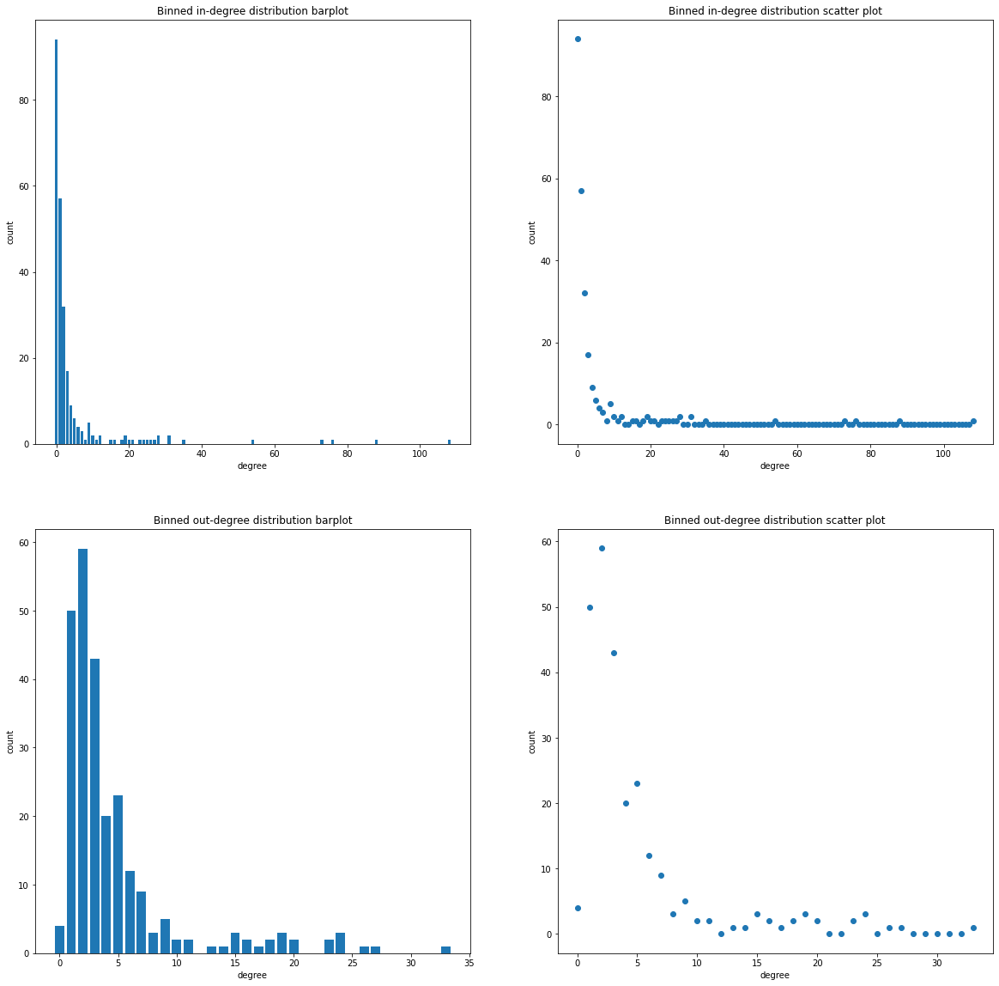

In [43]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(20, 20))

ax[0][0].bar(in_bins, in_bins_count, width=.8)

ax[0][0].set_title('Binned in-degree distribution barplot')
ax[0][0].set_xlabel("degree", fontsize=10)
ax[0][0].set_ylabel("count", fontsize=10)

# we use bar and scatter plots of the same distributions for better visualization purposes
ax[0][1].scatter(in_bins, in_bins_count)
ax[0][1].set_title('Binned in-degree distribution scatter plot')
ax[0][1].set_xlabel("degree", fontsize=10)
ax[0][1].set_ylabel("count", fontsize=10)

ax[1][0].bar(out_bins, out_bins_count, width=.8)
ax[1][0].set_title('Binned out-degree distribution barplot')
ax[1][0].set_xlabel("degree", fontsize=10)
ax[1][0].set_ylabel("count", fontsize=10)

ax[1][1].scatter(out_bins, out_bins_count)
ax[1][1].set_title('Binned out-degree distribution scatter plot')
ax[1][1].set_xlabel("degree", fontsize=10)
ax[1][1].set_ylabel("count", fontsize=10)

plt.show()

 * **What do you observe?**

The first thing that we can observe is that maximum out-degree is almost 4 times smaller than maximum in-degree, which could have also be seen in the previous question, when we examined the top nodes based on in- and out-degree, Michael and Andy. 

In the in-degree plots it can be seen that there majority of nodes, nearly 100, have a degree of 0, and the degree ranges until 120. Hence, the distribution shows that a large number of characters point to a small number of characters. While in the out-degree plots, the degree distribution changes slower than the in-degree, and the degrees are more concentrated between 0 and 10, in comparison to the in-degre.

* **Can you explain why the in-degree distribution is different from the out-degree distribution?**

Because of the nature of the network. In this network, the link is defined between two characters, $A$ and $B$, if there exists a hyperlink in character's $A$ page that link to $B$'s page. Popular characters will therefore be linked by a lot of other characters, which can accounts for highers in-degrees. Therefore, for less popular characters, will have links pointing to other characters, but very little links pointing to them, which can cause the large amout in-degrees close to 0.

The out-degree might be limited by the page length and the fact that every characters includes a low number of hyperlinks in its page.

* **Find the exponent of the degree distribution (by using the `powerlaw` package) for the in- and out-degree distribution. What does it say about our network?**

In [44]:
in_exponent, out_exponent = powerlaw.Fit(in_degrees).alpha, powerlaw.Fit(out_degrees).alpha
print(f"The exponent of the in-degree distribution is {in_exponent:.4f}.")
print(f"The exponent of the out-degree distribution is {out_exponent:.4f}.")

Calculating best minimal value for power law fit
Calculating best minimal value for power law fit
The exponent of the in-degree distribution is 1.9982.
The exponent of the out-degree distribution is 2.6148.


Values less than or equal to 0 in data. Throwing out 0 or negative values
Values less than or equal to 0 in data. Throwing out 0 or negative values


* **Compare the degree distribution of the undirected graph to a *random network* with the same number of nodes and probability of connection *p*. Comment your results.**

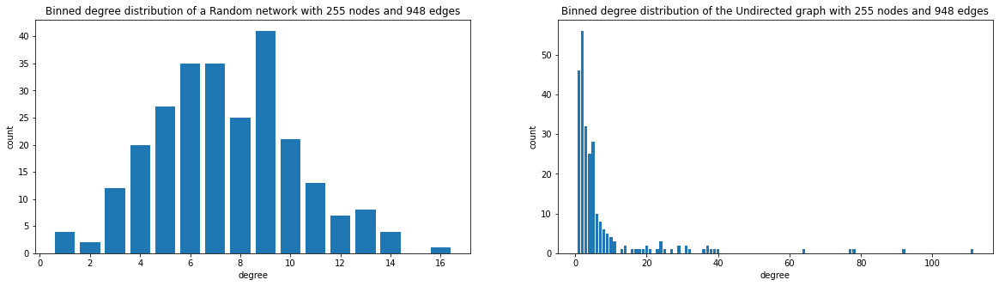

In [45]:
total_gu_nodes = len(G_undirected.nodes()) # compute the number of nodes in the undirected graph
total_gu_links = len(G_undirected.edges()) # compute the number of edges/links in the undirected graph

# Generate a random graph with the same number of nodes and edges (same probability of connection)
random_G = nx.gnm_random_graph(n=total_gu_nodes, m=total_gu_links)

random_g_bins, random_g_bins_count = get_degree_distribution(list(dict(random_G.degree()).values()))
gu_bins, gu_bins_count = get_degree_distribution(list(dict(G_undirected.degree()).values()))

fig, (ax_0, ax_1) = plt.subplots(ncols=2, figsize=(20, 5))

ax_0.bar(random_g_bins, random_g_bins_count, width=.8)

ax_0.set_title(f'Binned degree distribution of a Random network with {total_gu_nodes} nodes and {total_gu_links} edges')
ax_0.set_xlabel("degree", fontsize=10)
ax_0.set_ylabel("count", fontsize=10)

ax_1.bar(gu_bins, gu_bins_count)
ax_1.set_title(f'Binned degree distribution of the Undirected graph with {total_gu_nodes} nodes and {total_gu_links} edges')
ax_1.set_xlabel("degree", fontsize=10)
ax_1.set_ylabel("count", fontsize=10)

plt.show()

### _Exercise 1b_: Visualization (see lecture 5 for more hints)


* **Create a nice visualization of the total (undirected) network:**
>   * Set the nodes icon to be the characters thumbnail
>   * Get node positions based on the spring_layout (Force atlas did not work);
>   * Whatever else you feel like that would make the visualization nicer.

In [46]:
# Create ForceAtlas2 object with desired parameters
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=True,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=1.7,
                          strongGravityMode=False,
                          gravity=1.0,

                          # Log
                          verbose=True)

# get positions based on the force atlas 2 algorithm
positions = forceatlas2.forceatlas2_networkx_layout(G_undirected, pos=None, iterations=1000)

100%|██████████| 1000/1000 [00:01<00:00, 676.85it/s]

BarnesHut Approximation  took  0.37  seconds
Repulsion forces  took  0.90  seconds
Gravitational forces  took  0.02  seconds
Attraction forces  took  0.02  seconds
AdjustSpeedAndApplyForces step  took  0.08  seconds


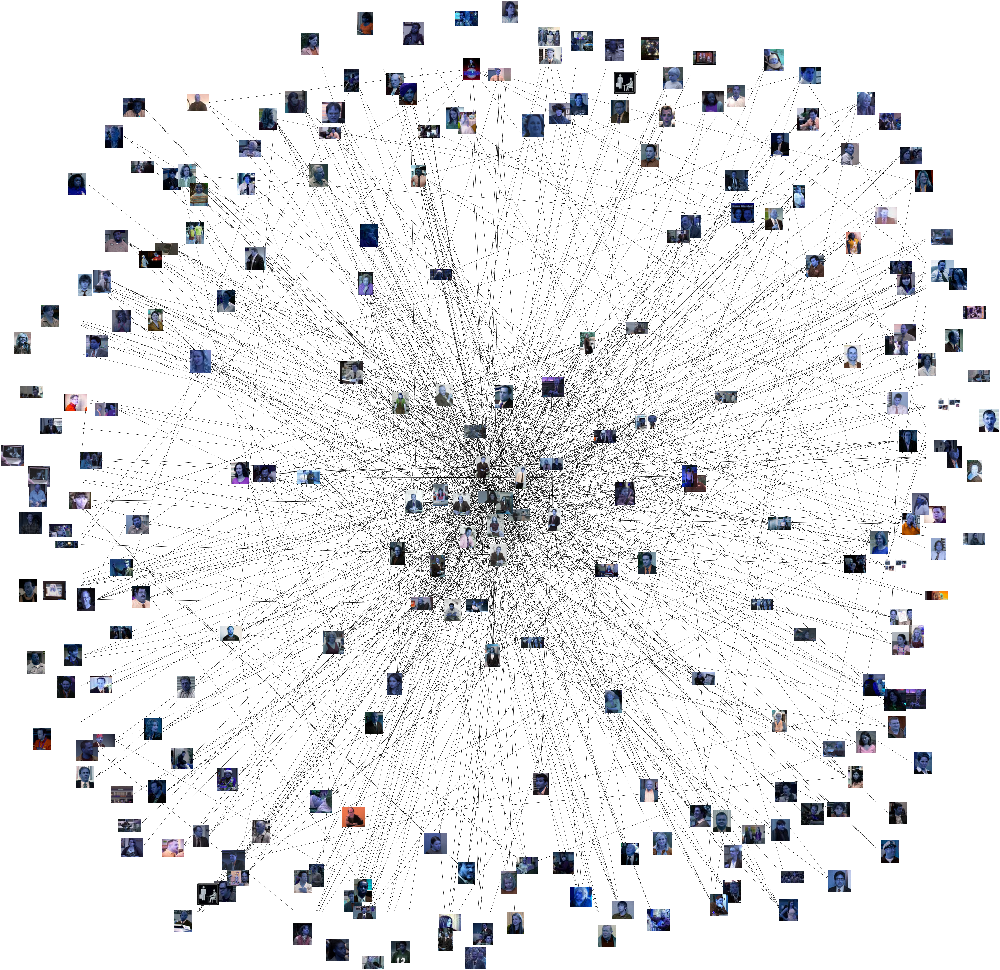

In [47]:
pos = nx.spring_layout(G_undirected, k = 0.5, iterations=20, scale=1.7) 
fig = plt.figure( figsize = (100, 100))
ax = plt.subplot(111)
ax.set_aspect('equal')
nx.draw_networkx_edges(G_undirected, pos, ax=ax)

plt.xlim(-1.5, 1.5)
plt.ylim(-1.5, 1.5)

trans = ax.transData.transform
trans2 = fig.transFigure.inverted().transform

piesize = 0.02  # this is the image size
p2 = piesize / 2.0
for n in G_undirected.nodes:
    xx , yy = trans(pos[n]) # figure coordinates
    xa , ya = trans2((xx , yy)) # axes coordinates
    a  =  plt.axes([xa - p2 , ya - p2 , piesize, piesize])
    a.set_aspect('equal')
    try :
        img = cv2.imread("./data/thumbnails/" + G_undirected.nodes[n]['img'])
        a.imshow(img)    
    except Exception :
        print(n)
        continue
    a.axis ('off')
ax.axis ('off')
plt.savefig ("network.png")

# IMDb: The Office Episode Raitings

Next we further complement our data with the raitings from each episode of The Offie, for all the 9 seasons using IMDb:https://www.imdb.com/title/tt0386676/episodes/_ajax.


IMDb doesn't have official API, so have found the id of The Office in IMDb: tt0386676, next we query the data for each episode:

In [48]:
imdb_url =  "https://www.imdb.com/title/tt0386676/episodes/_ajax"
number_of_seasons = 9

We use the requests library instead of urllib3, and the python `BeautifulSoup` library, as we are making ajax requests.

We make one request for each of the 9 seasons. For each request we extract: the season raitings, episode titles, votes, episode air dates and episodes.

The result is a data set consisting of 6 attributes, namely: the season of the show, episode number for each rating, title for each episode, IMDb raiting, number of votes, and air date of the episode

In [49]:
def get_raitings_and_votes(soup):
    ratings = []
    votes = []
    episodes = []
    
    rating_divs = soup.findAll("div", {"class": "ipl-rating-widget"})
    
    for index, div in enumerate(rating_divs):
        episodes.append(index + 1)

        # Find IMDb rating
        rating_div_inner = div.findAll("div", {"ipl-rating-star small"})
        soup_inner_rating = rating_div_inner[0].findAll("span", {"ipl-rating-star__rating"})
        ratings.append(soup_inner_rating[0].string)

        # Find total votes
        soup_inner_votes = rating_div_inner[0].findAll("span", {"ipl-rating-star__total-votes"})
        votes_string = soup_inner_votes[0].string
        votes_string = votes_string.replace(',', '')
        votes_string = votes_string.replace('(', '')
        votes_string = votes_string.replace(')', '')
        votes.append(int(votes_string))
        
    return episodes, ratings, votes

In [50]:
def get_episode_titles(soup):
    titles = []
    title_divs = soup.findAll("strong")
        
    for div in title_divs:
        titles.append(div.string) 
        
    #Popping the extra title (eg Season 1, Season 2, etcc) at end for each season (not required)
    titles.pop()
    
    return titles

In [51]:
def get_airdates(soup):
    airdates = []
    
    airdate_divs = soup.findAll("div", {"class": "airdate"})
    for div in airdate_divs:
        airdate_string = div.string
        airdate_string = airdate_string.replace('.', '')
        airdate_string = airdate_string.strip()
        airdates.append(airdate_string)
        
    return airdates

In [52]:
def get_episodes_description(soup):
    desciptions = []
    
    description_divs = soup.findAll("div", {"class": "item_description"})

    for description in description_divs:
        description_string = description.string.strip()
        desciptions.append(description_string)
    
    return desciptions

In [53]:
imdb_df = pd.DataFrame([])

for season in range(1, number_of_seasons + 1):
    print(f'Finding IMDb data for season {season}...')

    r = requests.get(url = imdb_url, params = {'season': season})
    
    # URL response is in HTML format
    soup = BeautifulSoup(r.content, 'html.parser')
    
    episodes, ratings, votes = get_raitings_and_votes(soup)
    titles = get_episode_titles(soup)
    airdates = get_airdates(soup)
    descriptions = get_episodes_description(soup)

    number_of_ep = len(ratings)
    seasons = [season] * number_of_ep
    
    # Preparing data for current season    
    data = {'Season': seasons, 'Episode': episodes, 'EpisodeTitle': titles, 'IMDBRating': ratings, 'TotalVotes': votes, 'AirDate': airdates, 'Description': descriptions}
    imdb_season_df = pd.DataFrame(data)
    imdb_df = imdb_df.append(imdb_season_df)

Finding IMDb data for season 1...
Finding IMDb data for season 2...
Finding IMDb data for season 3...
Finding IMDb data for season 4...
Finding IMDb data for season 5...
Finding IMDb data for season 6...
Finding IMDb data for season 7...
Finding IMDb data for season 8...
Finding IMDb data for season 9...


Next we examine the IMDb dataframe and we save it to csv:

In [54]:
imdb_df.head()

,Season,Episode,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description
0,1,1,Pilot,7.4,7034,24 Mar 2005,The premiere episode introduces the boss and s...
1,1,2,Diversity Day,8.3,6933,16 Mar 2005,Michael's off color remark puts a sensitivity ...
2,1,3,Health Care,7.7,5785,5 Apr 2005,Michael leaves Dwight in charge of picking the...
3,1,4,The Alliance,8.0,5610,12 Apr 2005,"Just for a laugh, Jim agrees to an alliance wi..."
4,1,5,Basketball,8.4,6217,19 Apr 2005,Michael and his staff challenge the warehouse ...


We further extend this data with the guest starts, directors and writers that we get from Kaggle:

# Kaggle dataset: The Office Dataset



 We extract the data from an existing Kaggle dataset and we load it into a dataframe by extracting the following columns: GuestStarts, Director, Writers. 

In [55]:
api = KaggleApi()
api.authenticate()

api.dataset_download_file('nehaprabhavalkar/the-office-dataset','the_office_series.csv', path='./data/kaggle_data')

False

In [56]:
office_df = pd.read_csv('data/kaggle_data/the_office_series.csv', usecols=['Season', 'EpisodeTitle', 'GuestStars', 'Director', 'Writers'])
office_df.head()

,Season,EpisodeTitle,GuestStars,Director,Writers
0,1,Pilot,NaN,Ken Kwapis,Ricky Gervais |Stephen Merchant and Greg Daniels
1,1,Diversity Day,NaN,Ken Kwapis,B. J. Novak
2,1,Health Care,NaN,Ken Whittingham,Paul Lieberstein
3,1,The Alliance,NaN,Bryan Gordon,Michael Schur
4,1,Basketball,NaN,Greg Daniels,Greg Daniels


In [57]:
office_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 188 entries, 0 to 187
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Season        188 non-null    int64 
 1   EpisodeTitle  188 non-null    object
 2   GuestStars    29 non-null     object
 3   Director      188 non-null    object
 4   Writers       188 non-null    object
dtypes: int64(1), object(4)
memory usage: 7.5+ KB


Now we merge this data set with the IMDb data about raitings.

In [58]:
imdb_df = imdb_df.merge(office_df, on=['Season', 'EpisodeTitle'])
imdb_df.head()

,Season,Episode,EpisodeTitle,IMDBRating,TotalVotes,AirDate,Description,GuestStars,Director,Writers
0,1,1,Pilot,7.4,7034,24 Mar 2005,The premiere episode introduces the boss and s...,NaN,Ken Kwapis,Ricky Gervais |Stephen Merchant and Greg Daniels
1,1,2,Diversity Day,8.3,6933,16 Mar 2005,Michael's off color remark puts a sensitivity ...,NaN,Ken Kwapis,B. J. Novak
2,1,3,Health Care,7.7,5785,5 Apr 2005,Michael leaves Dwight in charge of picking the...,NaN,Ken Whittingham,Paul Lieberstein
3,1,4,The Alliance,8.0,5610,12 Apr 2005,"Just for a laugh, Jim agrees to an alliance wi...",NaN,Bryan Gordon,Michael Schur
4,1,5,Basketball,8.4,6217,19 Apr 2005,Michael and his staff challenge the warehouse ...,NaN,Greg Daniels,Greg Daniels


In [59]:
imdb_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 188 entries, 0 to 187
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Season        188 non-null    int64 
 1   Episode       188 non-null    int64 
 2   EpisodeTitle  188 non-null    object
 3   IMDBRating    188 non-null    object
 4   TotalVotes    188 non-null    int64 
 5   AirDate       188 non-null    object
 6   Description   188 non-null    object
 7   GuestStars    29 non-null     object
 8   Director      188 non-null    object
 9   Writers       188 non-null    object
dtypes: int64(3), object(7)
memory usage: 16.2+ KB


In [60]:
imdb_df.to_csv("data/imdb_ratings.csv")

 # Kaggle dataset: The Office (US) - Complete Dialogue/Transcript

We extract the data from an existing Kaggle dataset and we load it into a dataframe to do exploratory data analysis:

In [61]:
api = KaggleApi()
api.authenticate()

api.dataset_download_file('nasirkhalid24/the-office-us-complete-dialoguetranscript','The-Office-Lines-V4.csv', path='./data/kaggle_data')
with zipfile.ZipFile('./data/kaggle_data/The-Office-Lines-V4.csv.zip', 'r') as zip_ref:
    zip_ref.extractall('./data')

In [62]:
transcripts_df = pd.read_csv('data/The-Office-Lines-V4.csv')
transcripts_df = transcripts_df.drop('Unnamed: 6', axis=1)

transcripts_df.head()

,season,episode,title,scene,speaker,line
0,1,1,Pilot,1,Michael,All right Jim. Your quarterlies look very good...
1,1,1,Pilot,1,Jim,"Oh, I told you. I couldn't close it. So..."
2,1,1,Pilot,1,Michael,So you've come to the master for guidance? Is ...
3,1,1,Pilot,1,Jim,"Actually, you called me in here, but yeah."
4,1,1,Pilot,1,Michael,"All right. Well, let me show you how it's done."


In [63]:
transcripts_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54626 entries, 0 to 54625
Data columns (total 6 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   season   54626 non-null  int64 
 1   episode  54626 non-null  int64 
 2   title    54626 non-null  object
 3   scene    54626 non-null  int64 
 4   speaker  54626 non-null  object
 5   line     54626 non-null  object
dtypes: int64(3), object(3)
memory usage: 2.5+ MB


The data downloaded consists of 5 attributes, namely: the season of the show, episode number for each dialogue, the character in the show saying the dialog and the line or dialogue the character says.

The goal is now to perform sentiment analysis of each character in the series and create a wordcloud for each main character in the series. From the data download from the Dunderpedia, we could see that the main characters are: 

In [64]:
main_characters = df.loc[df['Main Role'] == 'Main Characters']['Name']
list(main_characters)

['Andy Bernard',
 'Angela Martin',
 'Clark Green',
 'Creed Bratton',
 'Darryl Philbin',
 'Dwight Schrute',
 'Erin Hannon',
 'Gabe Lewis',
 'Jan Levinson',
 'Jim Halpert',
 'Karen Filippelli',
 'Kelly Kapoor',
 'Kevin Malone',
 'Meredith Palmer',
 'Michael Scott',
 'Nellie Bertram',
 'Oscar Martinez',
 'Pam Beesly',
 'Pete Miller',
 'Phyllis Vance',
 'Robert California',
 'Roy Anderson',
 'Ryan Howard',
 'Stanley Hudson',
 'Toby Flenderson']